In [1]:
import slam
from slam.differential_geometry import laplacian_texture_smoothing
import slam.io as sio
import slam.curvature as scurv

In [2]:
import matplotlib.cm as cm
import matplotlib as mpl
import matplotlib.pyplot as plt
import trimesh
import numpy as np
import pickle

In [3]:
import os
import meshio
import fenics
import vedo.dolfin
from scipy.optimize import curve_fit

In [4]:
def textureToColors(texture, cmap=cm.jet):
    norm = mpl.colors.Normalize(vmin=np.min(texture), vmax=np.max(texture))
    m = cm.ScalarMappable(norm=norm, cmap=cmap)
    colors=m.to_rgba(texture).squeeze()[:,0:3]
    return colors

In [5]:
###############
# Data (.stl) #
###############

In [6]:
# dHCP
folder_dHCP_21_28GW_STL = "/home/anne/Desktop/ECCOMAS_validation/dHCP/stl_transformed/"

surface_names_dHCP = (#"transformed_dhcp21GW_isotropic_Taubin50",
                     "transformed_dhcp22GW_isotropic_Taubin50",
                     "transformed_dhcp23GW_isotropic_Taubin20",
                     "transformed_dhcp24GW_isotropic_Taubin50",
                     "transformed_dhcp25GW_isotropic_Taubin20",
                     "transformed_dhcp26GW_isotropic_Taubin20",
                     "transformed_dhcp27GW_isotropic_Taubin20",
                     "transformed_dhcp28GW_isotropic_Taubin5")

"""("transformed_dhcp21GW_isotropic",
     "transformed_dhcp22GW_isotropic",
     "transformed_dhcp23GW_isotropic",
     "transformed_dhcp24GW_isotropic",
     "transformed_dhcp25GW_isotropic",
     "transformed_dhcp26GW_isotropic",
     "transformed_dhcp27GW_isotropic",
     "transformed_dhcp28GW_isotropic")"""

# initial smooth mesh (21GW)
############################
initial_smooth_mesh_path =  "/home/anne/Desktop/ECCOMAS_RESULTS_22aout2024/simulations_input_mesh_surface_21GW_RAW.stl"
initial_smooth_mesh = meshio.read(initial_smooth_mesh_path)

#######################
# H0 = 1.8E-3 m (cst) #
#######################

# simulation alphaTANcst_H0cst
##############################
folder_alphaTANcst_H0cst_21_30_GW = '/home/anne/Desktop/ECCOMAS_RESULTS_22aout2024/H0_cst/alphaTANcst_H0cst_STL_21_30GW/'

surface_names_alphaTANcst_H0cst = ("simulation_H0cst_alphaTANcst_H0cst_22GW",
                                     "simulation_alphaTANcst_H0cst_23GW",
                                     "simulation_alphaTANcst_H0cst_24GW",
                                     "simulation_alphaTANcst_H0cst_25GW",
                                     "simulation_alphaTANcst_H0cst_26GW",
                                     "simulation_alphaTANcst_H0cst_27GW",
                                     "simulation_alphaTANcst_H0cst_28GW")

# simulation alphaTAN_1over1plusFA_H0cst
########################################
folder_alphaTAN_1over1plusFA_H0cst_21_30_GW = '/home/anne/Desktop/ECCOMAS_RESULTS_22aout2024/H0_cst/alphaTAN_1over1plusFA_H0cst_STL_21_30GW/'

surface_names_1over1plusFA_H0cst = ("simulation_H0cst_alphaTAN_1over1plusFA_22GW",
                                         "simulation_alphaTAN_1over1plusFA_H0cst_23GW",
                                         "simulation_alphaTAN_1over1plusFA_H0cst_24GW",
                                         "simulation_alphaTAN_1over1plusFA_H0cst_25GW",
                                         "simulation_alphaTAN_1over1plusFA_H0cst_26GW",
                                         "simulation_alphaTAN_1over1plusFA_H0cst_27GW",
                                         "simulation_alphaTAN_1over1plusFA_H0cst_28GW")

# simulation alphaTAN_1over1plusFA_exp_H0cst
############################################
folder_alphaTAN_1over1plusFA_exp_H0cst_21_30_GW = '/home/anne/Desktop/ECCOMAS_RESULTS_22aout2024/H0_cst/alphaTAN_1over1plusFA_exp_H0cst_STL_21_30GW/'

surface_names_1over1plusFA_exp_H0cst = ("simulation_alphaTAN_1over1plusFA_exp_H0cst_22GW",
                                         "simulation_alphaTAN_1over1plusFA_exp_H0cst_23GW",
                                         "simulation_alphaTAN_1over1plusFA_exp_H0cst_24GW",
                                         "simulation_alphaTAN_1over1plusFA_exp_H0cst_25GW",
                                         "simulation_alphaTAN_1over1plusFA_exp_H0cst_26GW",
                                         "simulation_alphaTAN_1over1plusFA_exp_H0cst_27GW",
                                         "simulation_alphaTAN_1over1plusFA_exp_H0cst_28GW")

########################
# H0 from segmentation #
########################

# simulation alphaTANcst_H0segmentation
#######################################
folder_alphaTANcst_H0segmentation_21_30_GW = '/home/anne/Desktop/ECCOMAS_RESULTS_22aout2024/H0_segmentation/alphaTANcst_H0segmentation_STL_21_30GW/'

surface_names_alphaTANcst_H0segmentation = ("simulation_alphaTANcst_H0segmentation_22GW",
                                     "simulation_alphaTANcst_H0segmentation_23GW",
                                     "simulation_alphaTANcst_H0segmentation_24GW",
                                     "simulation_alphaTANcst_H0segmentation_25GW",
                                     "simulation_alphaTANcst_H0segmentation_26GW",
                                     "simulation_alphaTANcst_H0segmentation_27GW",
                                     "simulation_alphaTANcst_H0segmentation_28GW")

# simulation alphaTAN_1over1plusFA_H0segmentation
#################################################
folder_alphaTAN_1over1plusFA_H0segmentation_21_30_GW = '/home/anne/Desktop/ECCOMAS_RESULTS_22aout2024/H0_segmentation/alphaTAN_1over1plusFA_H0segmentation_STL_21_30GW/'

surface_names_alphaTAN_1over1plusFA_H0segmentation = ("simulation_H0seg_alphaTAN_1over1plusFA_22GW",
                                         "simulation_alphaTAN_1over1plusFA_H0segmentation_23GW",
                                         "simulation_alphaTAN_1over1plusFA_H0segmentation_24GW",
                                         "simulation_alphaTAN_1over1plusFA_H0segmentation_25GW",
                                         "simulation_alphaTAN_1over1plusFA_H0segmentation_26GW",
                                         "simulation_alphaTAN_1over1plusFA_H0segmentation_27GW",
                                         "simulation_alphaTAN_1over1plusFA_H0segmentation_28GW")

# simulation alphaTAN_1over1plusFA_exp_H0segmentation
#####################################################
folder_alphaTAN_1over1plusFA_exp_H0segmentation_21_28_GW = '/home/anne/Desktop/ECCOMAS_RESULTS_22aout2024/H0_segmentation/alphaTAN_1over1plusFA_exp_H0segmentation_STL_21_28GW/'

surface_names_alphaTAN_1over1plusFA_exp_H0segmentation = ("simulation_H0seg_alphaTAN_1over1plusFA_exp_22GW",
                                         "simulation_alphaTAN_1over1plusFA_exp_H0segmentation_23GW",
                                         "simulation_alphaTAN_1over1plusFA_exp_H0segmentation_24GW",
                                         "simulation_alphaTAN_1over1plusFA_exp_H0segmentation_25GW",
                                         "simulation_alphaTAN_1over1plusFA_exp_H0segmentation_26GW",
                                         "simulation_alphaTAN_1over1plusFA_exp_H0segmentation_27GW",
                                         "simulation_alphaTAN_1over1plusFA_exp_H0segmentation_28GW")


##############################
# H0 from segmentation (RAW) #
##############################
# simulation alphaTANcst_H0segmentation
#######################################
folder_alphaTANcst_H0segmentation_21_30_GW_RAW = '/home/anne/Desktop/ECCOMAS_RESULTS_22aout2024/H0_segmentation/alphaTANcst_H0segmentation_STL_21_30GW_RAW/'

surface_names_alphaTANcst_H0segmentation_RAW = ("simulation_alphaTANcst_H0segmentation_22GW",
                                                 "simulation_H0seg_alphaTANcst_23GW",
                                                 "simulation_H0seg_alphaTANcst_24GW",
                                                 "simulation_H0seg_alphaTANcst_25GW",
                                                 "simulation_H0seg_alphaTANcst_26GW",
                                                 "simulation_H0seg_alphaTANcst_27GW",
                                                 "simulation_H0seg_alphaTANcst_28GW")

In [7]:
##############
# Choose tGW #
##############

tGW_ID = 6 # tGW = 28GW

# dHCP ground truth atlas mesh 

In [9]:
# metrics: shape index, mean curvature, smoothed mean curvature, histogram of mean curvature, DPF

In [10]:
##########################
# Open stl with trimesh
mesh_dHCP = trimesh.load(folder_dHCP_21_28GW_STL + surface_names_dHCP[tGW_ID] + ".stl")

In [11]:
folder_dHCP_21_28GW_STL + surface_names_dHCP[tGW_ID] + ".stl"

'/home/anne/Desktop/ECCOMAS_validation/dHCP/stl_transformed/transformed_dhcp28GW_isotropic_Taubin5.stl'

In [12]:
mesh_dHCP.show()

In [13]:
###############################################################################
# Compute estimations of principal curvatures
PrincipalCurvatures_dHCP, PrincipalDir1_dHCP, PrincipalDir2_dHCP = scurv.curvatures_and_derivatives(mesh_dHCP)

Calculating vertex normals .... Please wait
Finished calculating vertex normals
Calculating curvature tensors ... Please wait
Finished Calculating curvature tensors
Calculating Principal Components ... Please wait
Finished Calculating principal components


In [14]:
###############################################################################
# Compute mean curvature from principal curvatures
mean_curv_dHCP = 0.5 * (PrincipalCurvatures_dHCP[0, :] + PrincipalCurvatures_dHCP[1, :])

In [34]:
min_dHCP = np.min(np.abs(mean_curv_dHCP))
max_dHCP = np.max(np.abs(mean_curv_dHCP))
mean_dHCP = np.mean(np.abs(mean_curv_dHCP))

print("min: {}\nmax: {}\nmean: {}".format(min_dHCP, max_dHCP, mean_dHCP))

min: 1.2611775503428013e-05
max: 19808.707936122213
mean: 24.979343655590274


In [35]:
mesh_dHCP.visual.vertex_colors = textureToColors(mean_curv_dHCP)
mesh_dHCP.show()

In [31]:
log_mean_curv_dHCP_RAW = np.sign(mean_curv_dHCP) * np.log10(np.abs(mean_curv_dHCP))

min_dHCP = np.min(np.abs(log_mean_curv_dHCP_RAW))
max_dHCP = np.max(np.abs(log_mean_curv_dHCP_RAW))
mean_dHCP = np.mean(np.abs(log_mean_curv_dHCP_RAW))

print("min: {}\nmax: {}\nmean: {}".format(min_dHCP, max_dHCP, mean_dHCP))

min: 0.0001309775689731631
max: 4.8992237685370545
mean: 1.1644113156081568


In [32]:
mesh_dHCP.visual.vertex_colors = textureToColors(log_mean_curv_dHCP_RAW)
mesh_dHCP.show()

(array([1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        1.900e+01, 0.000e+00, 1.000e+00, 0.000e+00, 1.000e+00, 1.200e+01,
        2.000e+00, 7.000e+00, 3.000e+00, 8.000e+00, 5.000e+00, 7.000e+00,
        5.000e+00, 4.000e+00, 2.100e+01, 1.100e+01, 1.500e+01, 3.200e+01,
        4.300e+01, 4.400e+01, 5.600e+01, 6.400e+01, 8.000e+01, 9.700e+01,
        9.400e+01, 1.750e+02, 2.110e+02, 2.870e+02, 4.060e+02, 5.120e+02,
        7.390e+02, 9.550e+02, 1.175e+03, 1.480e+03, 1.657e+03, 1.541e+03,
        1.048e+03, 5.580e+02, 1.630e+02, 5.600e+01, 6.100e+01, 5.600e+01,
        4.300e+01, 5.700e+01, 5.300e+01, 7.600e+01, 1.070e+02, 1.660e+02,
        1.820e+02, 2.410e+02, 3.090e+02, 2.990e+02, 3.170e+02, 3.550e+02,
        2.600e+02, 2.800e+02, 2.210e+02, 2.190e+02, 2.260e+02, 1.920e+02,
        2.070e+02, 1.770e+02, 1.460e+02, 1.360e+02, 1.070e+02, 1.100e+02,
        7.300e+01, 8.600e+01, 5.400e+01, 5.300e+01, 2.900e+01, 3.300e+01,
        2.900e+01, 2.000e+01, 2.900e+0

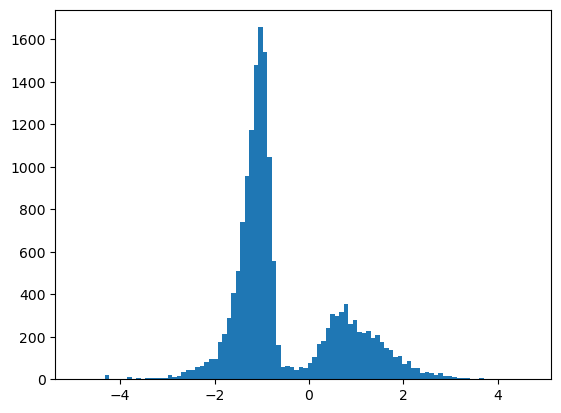

In [113]:
plt.hist(np.sign(mean_curv_dHCP)*np.log10(np.abs(mean_curv_dHCP)),bins=100)

In [15]:
###############################################################################
# Decomposition of the curvatures into ShapeIndex and Curvedness
# Based on 'Surface shape and curvature scales
#           Jan JKoenderink & Andrea Jvan Doorn'
shapeIndex_dHCP, curvedness_dHCP = scurv.decompose_curvature(PrincipalCurvatures_dHCP)

In [16]:
min_dHCP = np.min(np.abs(shapeIndex_dHCP))
max_dHCP = np.max(np.abs(shapeIndex_dHCP))
mean_dHCP = np.mean(np.abs(shapeIndex_dHCP))

print("min: {}\nmax: {}\nmean: {}".format(min_dHCP, max_dHCP, mean_dHCP))

min: 0.00022193434549289785
max: 0.9999999999999999
mean: 0.5176245916854495


In [17]:
smoothed_mean_curv_dHCP = laplacian_texture_smoothing(mesh_dHCP, mean_curv_dHCP, 1, 1e-5)
smoothed_shape_index_dHCP = laplacian_texture_smoothing(mesh_dHCP, shapeIndex_dHCP, 1, 5e-7)

    Smoothing texture
  Computing Laplacian
    Computing mesh weights of type fem
    -edge length threshold needed for  144  values =  0.1441008706094266  %
    -number of Nan in weights:  0  =  0.0  %
    -number of Negative values in weights:  812  =  0.8125687981587111  %
    -nb Nan in Laplacian :  0
    -nb Inf in Laplacian :  0
0
    OK
    Smoothing texture
  Computing Laplacian
    Computing mesh weights of type fem
    -edge length threshold needed for  144  values =  0.1441008706094266  %
    -number of Nan in weights:  0  =  0.0  %
    -number of Negative values in weights:  812  =  0.8125687981587111  %
    -nb Nan in Laplacian :  0
    -nb Inf in Laplacian :  0
0
    OK


In [19]:
#mesh_dHCP.visual.vertex_colors = textureToColors(mean_curv_dHCP)
#mesh_dHCP.visual.vertex_colors = textureToColors(-smoothed_mean_curv_dHCP)
#mesh_dHCP.visual.vertex_colors = textureToColors(np.sign(mean_curv_dHCP)*np.log10(np.abs(mean_curv_dHCP)))

#mesh_dHCP.visual.vertex_colors = textureToColors(shapeIndex_dHCP)
mesh_dHCP.visual.vertex_colors = textureToColors(smoothed_shape_index_dHCP)


mesh_dHCP.show()

# initial smooth mesh (for simulations)

In [8]:
initial_smooth_mesh = trimesh.load(initial_smooth_mesh_path)
initial_smooth_mesh.show()

In [9]:
###############################################################################
# Compute estimations of principal curvatures
PrincipalCurvatures_initial_smooth_mesh, PrincipalDir1_initial_smooth_mesh, PrincipalDir2_initial_smooth_mesh = scurv.curvatures_and_derivatives(initial_smooth_mesh)

Calculating vertex normals .... Please wait
Finished calculating vertex normals
Calculating curvature tensors ... Please wait
Finished Calculating curvature tensors
Calculating Principal Components ... Please wait
Finished Calculating principal components


In [10]:
###############################################################################
# Compute mean curvature from principal curvatures
mean_curv_simulation_initial_smooth_mesh = 0.5 * (PrincipalCurvatures_initial_smooth_mesh[0, :] + PrincipalCurvatures_initial_smooth_mesh[1, :])

In [11]:
###############################################################################
# Decomposition of the curvatures into ShapeIndex and Curvedness
# Based on 'Surface shape and curvature scales
#           Jan JKoenderink & Andrea Jvan Doorn'
shapeIndex_simulation_initial_smooth_mesh, curvedness_initial_smooth_mesh = scurv.decompose_curvature(PrincipalCurvatures_initial_smooth_mesh)

In [13]:
initial_smooth_mesh.visual.vertex_colors = textureToColors(shapeIndex_simulation_initial_smooth_mesh)
initial_smooth_mesh.show()

# simulations RAW

In [20]:
mesh_simulation_RAW = trimesh.load(folder_alphaTANcst_H0segmentation_21_30_GW_RAW + surface_names_alphaTANcst_H0segmentation_RAW[tGW_ID] + ".stl")

In [21]:
mesh_simulation_RAW.show()

In [11]:
###############################################################################
# Compute estimations of principal curvatures
PrincipalCurvatures_RAW, PrincipalDir1_RAW, PrincipalDir2_RAW = scurv.curvatures_and_derivatives(mesh_simulation_RAW)

Calculating vertex normals .... Please wait
Finished calculating vertex normals
Calculating curvature tensors ... Please wait
Finished Calculating curvature tensors
Calculating Principal Components ... Please wait
Finished Calculating principal components


In [12]:
###############################################################################
# Compute mean curvature from principal curvatures
mean_curv_simulation_RAW = 0.5 * (PrincipalCurvatures_RAW[0, :] + PrincipalCurvatures_RAW[1, :])

In [21]:
mean_curv_simulation_RAW

min = np.min(np.abs(mean_curv_simulation_RAW))
max = np.max(np.abs(mean_curv_simulation_RAW))
mean = np.mean(np.abs(mean_curv_simulation_RAW))

print("min: {}\nmax: {}\nmean: {}".format(min, max, mean))

min: 0.0022643393486134755
max: 143319.38906815875
mean: 197.7844304266755


In [24]:
mesh_simulation_RAW.visual.vertex_colors = textureToColors(mean_curv_simulation_RAW)
mesh_simulation_RAW.show()

In [22]:
log_mean_curv_simulation_RAW = np.sign(mean_curv_simulation_RAW) * np.log10(np.abs(mean_curv_simulation_RAW))

min = np.min(np.abs(log_mean_curv_simulation_RAW))
max = np.max(np.abs(log_mean_curv_simulation_RAW))
mean = np.mean(np.abs(log_mean_curv_simulation_RAW))

print("min: {}\nmax: {}\nmean: {}".format(min, max, mean))

min: 0.0002121750333827782
max: 5.156304948217957
mean: 1.959000276118188


In [25]:
mesh_simulation_RAW.visual.vertex_colors = textureToColors(log_mean_curv_simulation_RAW)
mesh_simulation_RAW.show()

(array([4.000e+00, 2.000e+00, 2.000e+00, 4.000e+00, 3.000e+00, 2.000e+00,
        2.000e+00, 5.000e+00, 3.000e+00, 4.000e+00, 1.000e+00, 3.000e+00,
        8.000e+00, 5.000e+00, 1.000e+01, 9.000e+00, 8.000e+00, 7.000e+00,
        1.300e+01, 1.100e+01, 8.000e+00, 1.600e+01, 2.800e+01, 5.400e+01,
        1.060e+02, 1.880e+02, 2.290e+02, 3.610e+02, 4.920e+02, 4.970e+02,
        6.650e+02, 8.360e+02, 1.017e+03, 1.117e+03, 1.267e+03, 1.303e+03,
        1.291e+03, 1.243e+03, 1.186e+03, 1.084e+03, 9.780e+02, 8.320e+02,
        7.590e+02, 6.660e+02, 5.770e+02, 5.410e+02, 4.290e+02, 3.730e+02,
        3.120e+02, 2.410e+02, 2.090e+02, 2.030e+02, 1.400e+02, 1.330e+02,
        1.080e+02, 1.100e+02, 8.800e+01, 7.200e+01, 7.100e+01, 6.800e+01,
        5.400e+01, 5.200e+01, 5.200e+01, 4.400e+01, 6.900e+01, 7.200e+01,
        6.000e+01, 8.400e+01, 9.500e+01, 1.490e+02, 1.290e+02, 1.800e+02,
        2.160e+02, 2.590e+02, 3.130e+02, 4.040e+02, 4.270e+02, 5.710e+02,
        7.200e+02, 8.750e+02, 1.070e+0

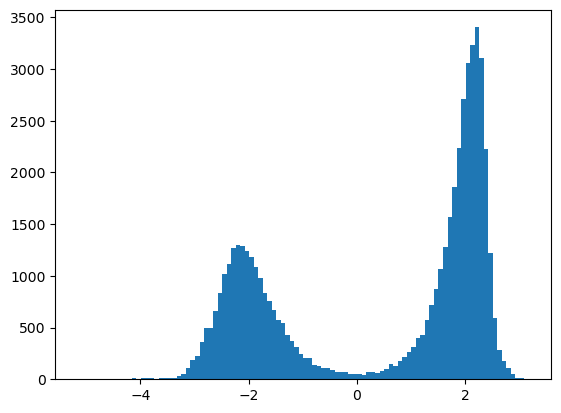

In [75]:
plt.hist(np.sign(mean_curv_simulation_RAW)*np.log10(np.abs(mean_curv_simulation_RAW)), bins=100)

In [76]:
###############################################################################
# Decomposition of the curvatures into ShapeIndex and Curvedness
# Based on 'Surface shape and curvature scales
#           Jan JKoenderink & Andrea Jvan Doorn'
shapeIndex_simulation_RAW, curvedness_RAW = scurv.decompose_curvature(PrincipalCurvatures_RAW)

In [77]:
smoothed_mean_curv_simulation_RAW = laplacian_texture_smoothing(mesh_simulation_RAW, mean_curv_simulation_RAW, 1, 1e-3) # 1e-5
smoothed_shape_index_simulation_RAW = laplacian_texture_smoothing(mesh_simulation_RAW, shapeIndex_simulation_RAW, 1, 5e-7)

    Smoothing texture
  Computing Laplacian
    Computing mesh weights of type fem
    -edge length threshold needed for  320  values =  0.10052271813429835  %
    -number of Nan in weights:  0  =  0.0  %
    -number of Negative values in weights:  52544  =  16.50583031765179  %
    -nb Nan in Laplacian :  0
    -nb Inf in Laplacian :  0
0
    OK
    Smoothing texture
  Computing Laplacian
    Computing mesh weights of type fem
    -edge length threshold needed for  320  values =  0.10052271813429835  %
    -number of Nan in weights:  0  =  0.0  %
    -number of Negative values in weights:  52544  =  16.50583031765179  %
    -nb Nan in Laplacian :  0
    -nb Inf in Laplacian :  0
0
    OK


In [78]:
#mesh_simulation_RAW.visual.vertex_colors = textureToColors(mean_curv_simulation_RAW)
#mesh_simulation_RAW.visual.vertex_colors = textureToColors(-smoothed_mean_curv_simulation_RAW)
mesh_simulation_RAW.visual.vertex_colors = textureToColors(np.sign(mean_curv_simulation_RAW)*np.log10(np.abs(mean_curv_simulation_RAW)))

#mesh_simulation_RAW.visual.vertex_colors = textureToColors(shapeIndex_simulation_RAW)
#mesh_simulation_RAW.visual.vertex_colors = textureToColors(smoothed_shape_index_simulation_RAW)

mesh_simulation.show()

# simulations

In [22]:
# metrics: shape index, mean curvature, smoothed mean curvature, histogram of mean curvature, DPF

In [22]:
##########################
# Open stl with trimesh

# H0 cst
# ------
#mesh_simulation = trimesh.load(folder_alphaTANcst_H0cst_21_30_GW + surface_names_alphaTANcst_H0cst[tGW_ID] + ".stl")
#mesh_simulation = trimesh.load(folder_alphaTAN_1over1plusFA_H0cst_21_30_GW + surface_names_1over1plusFA_H0cst[tGW_ID] + ".stl")
#mesh_simulation = trimesh.load(folder_alphaTAN_1over1plusFA_exp_H0cst_21_30_GW + surface_names_1over1plusFA_exp_H0cst[tGW_ID] + ".stl")

# H0 segmentation
# ---------------
#mesh_simulation = trimesh.load(folder_alphaTANcst_H0segmentation_21_30_GW + surface_names_alphaTANcst_H0segmentation[tGW_ID] + ".stl")
#mesh_simulation = trimesh.load(folder_alphaTAN_1over1plusFA_H0segmentation_21_30_GW + surface_names_alphaTAN_1over1plusFA_H0segmentation[tGW_ID] + ".stl")
mesh_simulation = trimesh.load(folder_alphaTAN_1over1plusFA_exp_H0segmentation_21_28_GW + surface_names_alphaTAN_1over1plusFA_exp_H0segmentation[tGW_ID] + ".stl")

"""
folder_alphaTANcst_H0cst_21_28_GW
surface_names_alphaTANcst_H0cst

folder_alphaTAN_1over1plusFA_H0cst_21_28_GW
surface_names_1over1plusFA_H0cst

folder_alphaTAN_1over1plusFA_exp_H0cst_21_28_GW
surface_names_1over1plusFA_exp_H0cst

#

folder_alphaTANcst_H0segmentation_21_28_GW
surface_names_alphaTANcst_H0segmentation

folder_alphaTAN_1over1plusFA_H0segmentation_21_28_GW
surface_names_alphaTAN_1over1plusFA_H0segmentation

folder_alphaTAN_1over1plusFA_exp_H0segmentation_21_28_GW
surface_names_alphaTAN_1over1plusFA_exp_H0segmentation
"""

'\nfolder_alphaTANcst_H0cst_21_28_GW\nsurface_names_alphaTANcst_H0cst\n\nfolder_alphaTAN_1over1plusFA_H0cst_21_28_GW\nsurface_names_1over1plusFA_H0cst\n\nfolder_alphaTAN_1over1plusFA_exp_H0cst_21_28_GW\nsurface_names_1over1plusFA_exp_H0cst\n\n#\n\nfolder_alphaTANcst_H0segmentation_21_28_GW\nsurface_names_alphaTANcst_H0segmentation\n\nfolder_alphaTAN_1over1plusFA_H0segmentation_21_28_GW\nsurface_names_alphaTAN_1over1plusFA_H0segmentation\n\nfolder_alphaTAN_1over1plusFA_exp_H0segmentation_21_28_GW\nsurface_names_alphaTAN_1over1plusFA_exp_H0segmentation\n'

In [23]:
mesh_simulation.show()

In [24]:
###############################################################################
# Compute estimations of principal curvatures
PrincipalCurvatures, PrincipalDir1, PrincipalDir2 = scurv.curvatures_and_derivatives(mesh_simulation)

Calculating vertex normals .... Please wait
Finished calculating vertex normals
Calculating curvature tensors ... Please wait
Finished Calculating curvature tensors
Calculating Principal Components ... Please wait
Finished Calculating principal components


In [25]:
###############################################################################
# Compute mean curvature from principal curvatures
mean_curv_simulation = 0.5 * (PrincipalCurvatures[0, :] + PrincipalCurvatures[1, :])

In [95]:
np.max(mean_curv_simulation)

846.8738328563672

(array([1.000e+00, 1.000e+00, 2.000e+00, 2.000e+00, 1.000e+00, 4.000e+00,
        3.000e+00, 1.000e+00, 3.000e+00, 2.000e+00, 6.000e+00, 2.000e+00,
        4.000e+00, 1.000e+00, 7.000e+00, 3.000e+00, 7.000e+00, 7.000e+00,
        4.000e+00, 1.100e+01, 1.000e+01, 6.000e+00, 9.000e+00, 1.300e+01,
        9.000e+00, 1.000e+01, 2.700e+01, 4.900e+01, 8.800e+01, 1.070e+02,
        1.940e+02, 2.780e+02, 3.590e+02, 4.080e+02, 4.730e+02, 5.710e+02,
        7.490e+02, 8.700e+02, 1.069e+03, 1.229e+03, 1.273e+03, 1.271e+03,
        1.251e+03, 1.111e+03, 1.066e+03, 9.700e+02, 8.400e+02, 7.010e+02,
        6.150e+02, 5.760e+02, 4.620e+02, 4.130e+02, 3.440e+02, 2.850e+02,
        2.180e+02, 1.930e+02, 1.780e+02, 1.570e+02, 1.220e+02, 9.700e+01,
        1.020e+02, 7.300e+01, 7.400e+01, 6.600e+01, 6.000e+01, 6.700e+01,
        5.100e+01, 6.300e+01, 6.400e+01, 7.500e+01, 9.400e+01, 9.500e+01,
        1.100e+02, 1.460e+02, 1.800e+02, 1.940e+02, 2.230e+02, 3.100e+02,
        3.580e+02, 4.530e+02, 6.210e+0

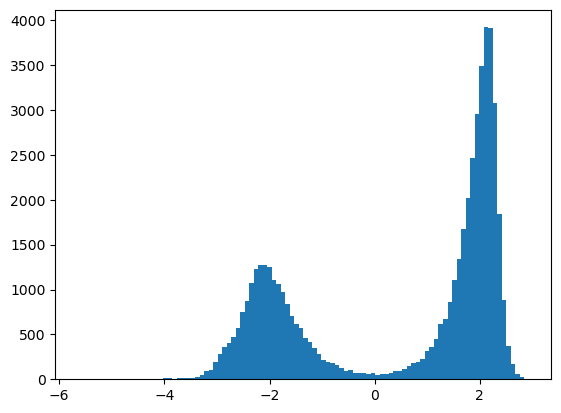

In [96]:
plt.hist(np.sign(mean_curv_simulation)*np.log10(np.abs(mean_curv_simulation)), bins=100)

In [26]:
###############################################################################
# Decomposition of the curvatures into ShapeIndex and Curvedness
# Based on 'Surface shape and curvature scales
#           Jan JKoenderink & Andrea Jvan Doorn'
shapeIndex_simulation, curvedness = scurv.decompose_curvature(PrincipalCurvatures)

In [27]:
smoothed_mean_curv_simulation = laplacian_texture_smoothing(mesh_simulation, mean_curv_simulation, 1, 1e-5) 
smoothed_shape_index_simulation = laplacian_texture_smoothing(mesh_simulation, shapeIndex_simulation, 1, 5e-7)

    Smoothing texture
  Computing Laplacian
    Computing mesh weights of type fem
    -edge length threshold needed for  428  values =  0.13444913550462403  %
    -number of Nan in weights:  0  =  0.0  %
    -number of Negative values in weights:  36640  =  11.509851226377162  %
    -nb Nan in Laplacian :  0
    -nb Inf in Laplacian :  0
0
    OK
    Smoothing texture
  Computing Laplacian
    Computing mesh weights of type fem
    -edge length threshold needed for  428  values =  0.13444913550462403  %
    -number of Nan in weights:  0  =  0.0  %
    -number of Negative values in weights:  36640  =  11.509851226377162  %
    -nb Nan in Laplacian :  0
    -nb Inf in Laplacian :  0
0
    OK


In [70]:
################################
# 
# curvature, directions = scurv.curvature_fit(mesh, tol=1e-12, neighbour_size=2)

In [29]:
#mesh_simulation.visual.vertex_colors = textureToColors(mean_curv_simulation)
#mesh_simulation.visual.vertex_colors = textureToColors(-smoothed_mean_curv_simulation)
#mesh_simulation.visual.vertex_colors = textureToColors(np.sign(mean_curv_simulation)*np.log10(np.abs(mean_curv_simulation)))

mesh_simulation.visual.vertex_colors = textureToColors(shapeIndex_simulation)
#mesh_simulation.visual.vertex_colors = textureToColors(smoothed_shape_index_simulation)

mesh_simulation.show()

In [101]:
mesh_simulation.visual.vertex_colors = textureToColors(shapeIndex_simulation)
mesh_simulation.show()

In [32]:
#####################
# Comparative plots #
#####################

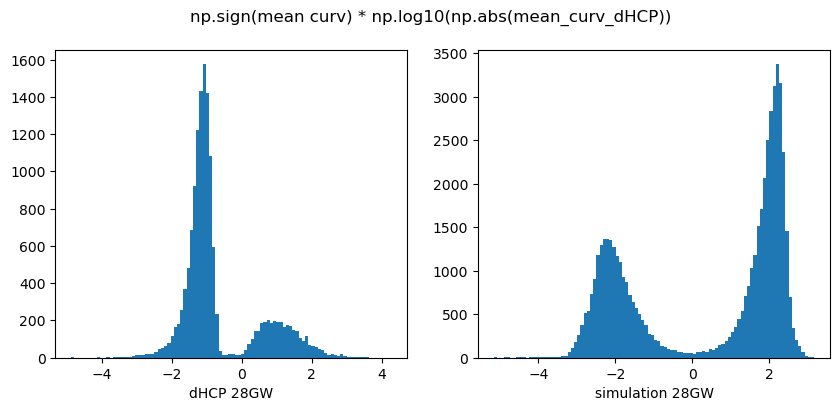

In [74]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))
fig.suptitle('np.sign(mean curv) * np.log10(np.abs(mean_curv_dHCP))')

#plt.subplot(11)
ax1.hist(np.sign(mean_curv_dHCP)*np.log10(np.abs(mean_curv_dHCP)),bins=100)
ax1.set_xlabel('dHCP 28GW')

#plt.subplot(12)
ax2.hist(np.sign(mean_curv_simulation)*np.log10(np.abs(mean_curv_simulation)),bins=100)
ax2.set_xlabel('simulation 28GW')

plt.show()

In [34]:
from trimesh.viewer import SceneViewer

In [54]:
"""
mesh_dHCP.visual.vertex_colors = textureToColors(shapeIndex_dHCP)

mesh_simulation.apply_translation([10, 0, 0])
mesh_simulation.visual.vertex_colors = textureToColors(shapeIndex_simulation)

meshes = [mesh_dHCP, mesh_simulation]

scene = trimesh.Scene(meshes)

#scene.camera.resolution = (800, 600)
#scene.camera.fov = (60, 60)  # Champ de vision
#scene.camera_transform = scene.camera.look_at(points=[mesh_dHCP.centroid, mesh_simulation.centroid])

#scene.show(viewer='notebook')

pjs_scene = scene.to_pythreejs() # convert trimesh scene into pythreejs scene

display(pjs_scene) # display pythreejs scene
"""

AttributeError: 'Scene' object has no attribute 'to_pythreejs'

# Corrélation plissement à 21w et à la fin de la simu (tGW_ID)

In [58]:
tGW_ID = 7 # 28GW

simulation_surface_meshes = (folder_alphaTANcst_H0cst_21_28_GW_GIFTI + surface_names_alphaTANcst_H0cst[tGW_ID] + ".gii",
                             folder_alphaTANFAbased_H0cst_21_28_GW_GIFTI + surface_names_alphaTANFAbased_H0cst[tGW_ID] + ".gii",
                             #folder_alphaTANcst_H0segmentation_21_28_GW_STL + surface_names_alphaTANcst_H0segmentation[tGW_ID] + ".gii",
                             folder_alphaTANFAbased_H0segmentation_21_28_GW_GIFTI + surface_names_alphaTANFAbased_H0segmentation[tGW_ID] + ".gii"
                            )

mesh_simulation_REF_21GW_path = sio.load_mesh(folder_alphaTANcst_H0cst_21_28_GW_GIFTI + surface_names_alphaTANcst_H0cst[0] + ".gii")


In [59]:
all_meshes = []
for name in simulation_surface_meshes:
    all_meshes.append(sio.load_mesh(name)) # all simulations results at tGW_ID (common end of simulation)

mesh_simulation_REF_21GW = sio.load_mesh(mesh_simulation_REF_21GW_path)
all_meshes.append(mesh_simulation_REF_21GW) # smooth reference at 21GW
    
all_SI = []
for mesh in all_meshes:
    PrincipalCurvatures, PrincipalDir1, PrincipalDir2 = scurv.curvatures_and_derivatives(mesh)
    SI, curvedness = scurv.decompose_curvature(PrincipalCurvatures)
    all_SI.append(SI)

TypeError: argument should be a str or an os.PathLike object where __fspath__ returns a str, not 'Trimesh'

In [56]:
PrincipalCurvatures, PrincipalDir1, PrincipalDir2 = scurv.curvatures_and_derivatives(mesh_simulation_REF_21GW)
SI_simulation_REF_21GW, curvedness = scurv.decompose_curvature(PrincipalCurvatures)

NameError: name 'mesh_dHCP_21GW' is not defined

In [60]:
all_SI.append(SI_simulation_REF_21GW)

NameError: name 'SI_21' is not defined

In [46]:
############
# Save

with open ( "shape_Indices" , "wb" ) as file :
    pickle.dump( [all_SI ,all_meshes, surface_names], file )

NameError: name 'surface_names' is not defined

In [27]:
############
# Load data

with open('shape_Indices', 'rb') as f:
    data = pickle.load(f)
    
all_SI = data[0]
all_meshes = data[1]
surface_names = data[2]
print(surface_names)

('dhcp21GWsmoothedTaubin50_wholebrain_Fgt_quasistatic_alphaTANcst_H0cst_28_2857', 'dhcp21GWsmoothedTaubin50_wholebrain_Fgt_quasistatic_alphaTANcst_H0segmentation_28_2857', 'dhcp21GWsmoothedTaubin50_wholebrain_Fgt_quasistatic_alphaTANFAbased_H0cst_28_2857', 'dhcp21GWsmoothedTaubin50_wholebrain_Fgt_quasistatic_alphaTANFAbased_H0segmentation_28_2857', 'dhcp21GWsmoothedTaubin50_21GW')


In [28]:
###########
# Correlation

np.corrcoef(all_SI)

array([[1.        , 0.91863149, 0.86881287, 0.83073948, 0.6069272 ,
        0.6069272 ],
       [0.91863149, 1.        , 0.8359917 , 0.86344976, 0.59504301,
        0.59504301],
       [0.86881287, 0.8359917 , 1.        , 0.91060528, 0.59608337,
        0.59608337],
       [0.83073948, 0.86344976, 0.91060528, 1.        , 0.56163464,
        0.56163464],
       [0.6069272 , 0.59504301, 0.59608337, 0.56163464, 1.        ,
        1.        ],
       [0.6069272 , 0.59504301, 0.59608337, 0.56163464, 1.        ,
        1.        ]])

In [29]:
################
# Lissage et correlation

from slam.differential_geometry import laplacian_texture_smoothing

all_smoothed_SI = []
for i in range(len(all_meshes)):
    mesh = all_meshes[i]
    shapeIndex = all_SI[i]
    smoothed_SI = laplacian_texture_smoothing(mesh, shapeIndex, 1, 1e-6)
    all_smoothed_SI.append(smoothed_SI)

    Smoothing texture
  Computing Laplacian
    Computing mesh weights of type fem
    -edge length threshold needed for  548  values =  0.17214515480498593  %
    -number of Nan in weights:  0  =  0.0  %
    -number of Negative values in weights:  31676  =  9.950492561318859  %
    -nb Nan in Laplacian :  0
    -nb Inf in Laplacian :  0
0
    OK
    Smoothing texture
  Computing Laplacian
    Computing mesh weights of type fem
    -edge length threshold needed for  548  values =  0.17214515480498593  %
    -number of Nan in weights:  0  =  0.0  %
    -number of Negative values in weights:  32246  =  10.129548652995577  %
    -nb Nan in Laplacian :  0
    -nb Inf in Laplacian :  0
0
    OK
    Smoothing texture
  Computing Laplacian
    Computing mesh weights of type fem
    -edge length threshold needed for  572  values =  0.1796843586650583  %
    -number of Nan in weights:  0  =  0.0  %
    -number of Negative values in weights:  32232  =  10.125150784077201  %
    -nb Nan in Laplac

In [30]:
###########
# Correlation

np.corrcoef(all_smoothed_SI)

array([[1.        , 0.96871601, 0.92694219, 0.90115159, 0.63630815,
        0.63630815],
       [0.96871601, 1.        , 0.91360546, 0.92074605, 0.62961081,
        0.62961081],
       [0.92694219, 0.91360546, 1.        , 0.96188256, 0.64824554,
        0.64824554],
       [0.90115159, 0.92074605, 0.96188256, 1.        , 0.60575427,
        0.60575427],
       [0.63630815, 0.62961081, 0.64824554, 0.60575427, 1.        ,
        1.        ],
       [0.63630815, 0.62961081, 0.64824554, 0.60575427, 1.        ,
        1.        ]])

In [31]:
simu = 3
mesh = all_meshes[simu]
SI = all_SI[simu]
smoothed_SI = laplacian_texture_smoothing(mesh, SI, 1, 1e-6)
mesh.visual.vertex_colors = textureToColors(-smoothed_SI)
mesh.show()

    Smoothing texture
  Computing Laplacian
    Computing mesh weights of type fem
    -edge length threshold needed for  580  values =  0.18219742661841576  %
    -number of Nan in weights:  0  =  0.0  %
    -number of Negative values in weights:  34238  =  10.755302573381584  %
    -nb Nan in Laplacian :  0
    -nb Inf in Laplacian :  0
0
    OK


# 3. Corrélations locales

In [9]:
from slam.geodesics import local_gdist_matrix, compute_gdist

In [10]:

simu = 3
mesh = all_meshes[simu]
area_radius = 0.0001

area_geodist = local_gdist_matrix(mesh, area_radius)

In [11]:
distance = compute_gdist(mesh, 0)
mesh.visual.vertex_colors = textureToColors(distance)
mesh.show()

In [12]:
mask = np.zeros((len(distance),))
mask[np.where(np.isinf(distance))]=1

In [13]:
mesh.visual.vertex_colors = textureToColors(mask)
mesh.show()